#A Deep Dive into Latent Space: Image Generation and Manipulation with StyleGAN2

###Notebook for a experimenting with StyleGAN 2 Model using PyTorch

### This Notebook codes need to run on GPU using CUDA for PyTorch, currently it is setup to run on the cloud enviornment such as Google Colab for free.



##Install dependencies

In [1]:
! pip install Ninja

import sys

from google.colab import files
from io import BytesIO
import requests

from PIL import Image

from IPython.display import HTML
from base64 import b64encode

     |████████████████████████████████| 112kB 3.4MB/s 


## Clone github repository and download StyleGAN2 weights



In [2]:
def clone_deepdive_repo():
  ! git clone https://github.com/terrybroad/deepdivelatentspace-tutorial-code
  sys.path.extend(['/content/deepdivelatentspace-tutorial-code/'])
  return 'gdrive/My Drive/deepdivelatentspace'
repo = clone_deepdive_repo()
%cd deepdivelatentspace-tutorial-code

Cloning into 'deepdivelatentspace-tutorial-code'...
remote: Enumerating objects: 5, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 127 (delta 0), reused 3 (delta 0), pack-reused 122
Receiving objects: 100% (127/127), 82.85 MiB | 36.49 MiB/s, done.
Resolving deltas: 100% (51/51), done.
/content/deepdivelatentspace-tutorial-code


In [3]:
# Download model weights
! gdown --id 12FUktPicnxeVNh57TM-_FLzADwZlMF_T  -O ckpt/stylegan2-ffhq.pt

Downloading...
From: https://drive.google.com/uc?id=12FUktPicnxeVNh57TM-_FLzADwZlMF_T
To: /content/deepdivelatentspace-tutorial-code/ckpt/stylegan2-ffhq.pt
133MB [00:01, 93.5MB/s]


#Interpolation loop in *z* space

So the first thing we are going to generate is a short looping video in the *z* latent space of styleGAN2. This is the input space which is designed to be sampled directly. The latent vectors we sample in *z* get transformed the by the Style Transformer MLP and projected into *w* space before being fed at various points into the StyleGAN2 generator module. This code samples random points in the space and interpolates between them, as you will see all the generated outputs will be highly realistic.

In [4]:
# Run script to interpolate in z space and generate individual samples
! python3 interpolation_loop_z.py --ckpt ckpt/stylegan2-ffhq.pt
# Sequence samples into video
! ffmpeg -i interpolation_loop_z/%06d.png -minrate 1024k -maxrate 1024k -c:v libx264 -pix_fmt yuv420p -strict -2 videos/interpolation_loop_z.mp4
# Delete image samples
! rm -rf interpolation_loop_z

100% 120/120 [01:14<00:00,  1.60it/s]
ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable

In [5]:
mp4 = open('videos/interpolation_loop_z.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

# Prepare images for projection into latent space

We have shown what can be done, with some sampling of random latent variables in the *z* space, now we are going to allow you to upload an image of yourself, or anyone you choose, and project it into StyleGAN2 *w* space. You can either upload an image from your computer, or load it from the web using a url.

## Upload an image file from your computer

Pick image from the picker tool
Requirement: allow third-party cookies, add `https://[*.]googleusercontent.com:443` to cookie whitelist

In [6]:
def img_from_local():
  uploaded = files.upload()
  filename = list(uploaded)[0]
  return BytesIO(uploaded[filename])

img_local = Image.open(img_from_local())
img_local.save('your local image path','PNG')
img_local

IndexError: ignored

## Pull image from URL

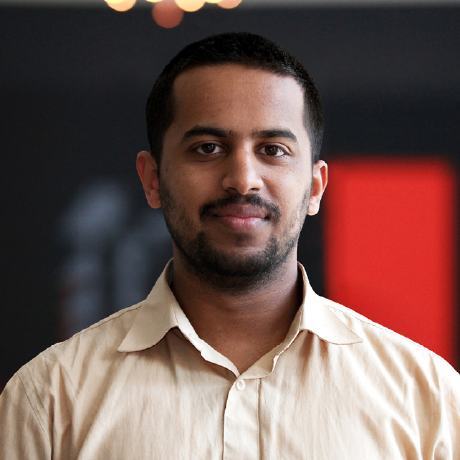

In [7]:
def img_from_url(url):
  response = requests.get(url)
  return BytesIO(response.content)
  
url = 'https://avatars1.githubusercontent.com/u/395039?s=460&u=aafb921a0db8ca28eb98c9fefe8b2a2962efe3a0&v=4'
img_url = Image.open(img_from_url(url))
img_url.save('input_images/raw/uploaded.png','PNG')
img_url

# Align image using FFHQ pre-processing
This process used face landmark detection to detect faces in the image and crop and align to image to fit the alignment used in the FFHQ dataset that this styleGAN2 model was trained on.
Note: sometimes more than one face is extracted, check files or try uploaded_02, uploaded_03 etc. 
If no faces are extracted, try a different image. 

2020-09-07 17:51:56.906767: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
64045056/64040097 [==============================] - 117s 2us/step
Aligning .gitignore ...
Getting landmarks...
Exception in landmark detection!
Aligning uploaded.png ...
Getting landmarks...
Starting face alignment...
Wrote result input_images/aligned/uploaded_01.png


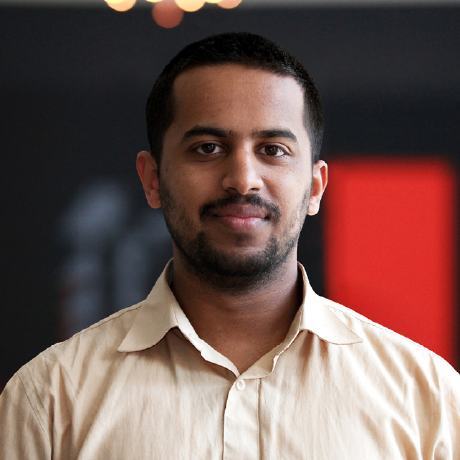

In [9]:
! python align_images.py
aligned_img = Image.open('input_images/raw/uploaded.png')
aligned_img


# Project image into *w* space (Prepare to be suprised :)

*   List item
*   List item


We are now going to take our aligned image, and project it into the *w* space of StyleGAN2. This process will start with a random vector, and make changes to the latent vector and noise input, until it converges on on the closest matching image in StyleGAN2 space to our input image. This is quite a long process, however if you want to shorten it you can change the the flag `--step` to  a smaller number if you want to reduce the amount of steps taken to find the closest match.



Setting up Perceptual loss...
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100% 528M/528M [00:02<00:00, 218MB/s]
Loading model from: /content/deepdivelatentspace-tutorial-code/lpips/weights/v0.1/vgg.pth
...[net-lin [vgg]] initialized
...Done
perceptual: 0.1910; noise regularize: 0.0000; mse: 0.0627; lr: 0.0000: 100% 500/500 [03:07<00:00,  2.67it/s]


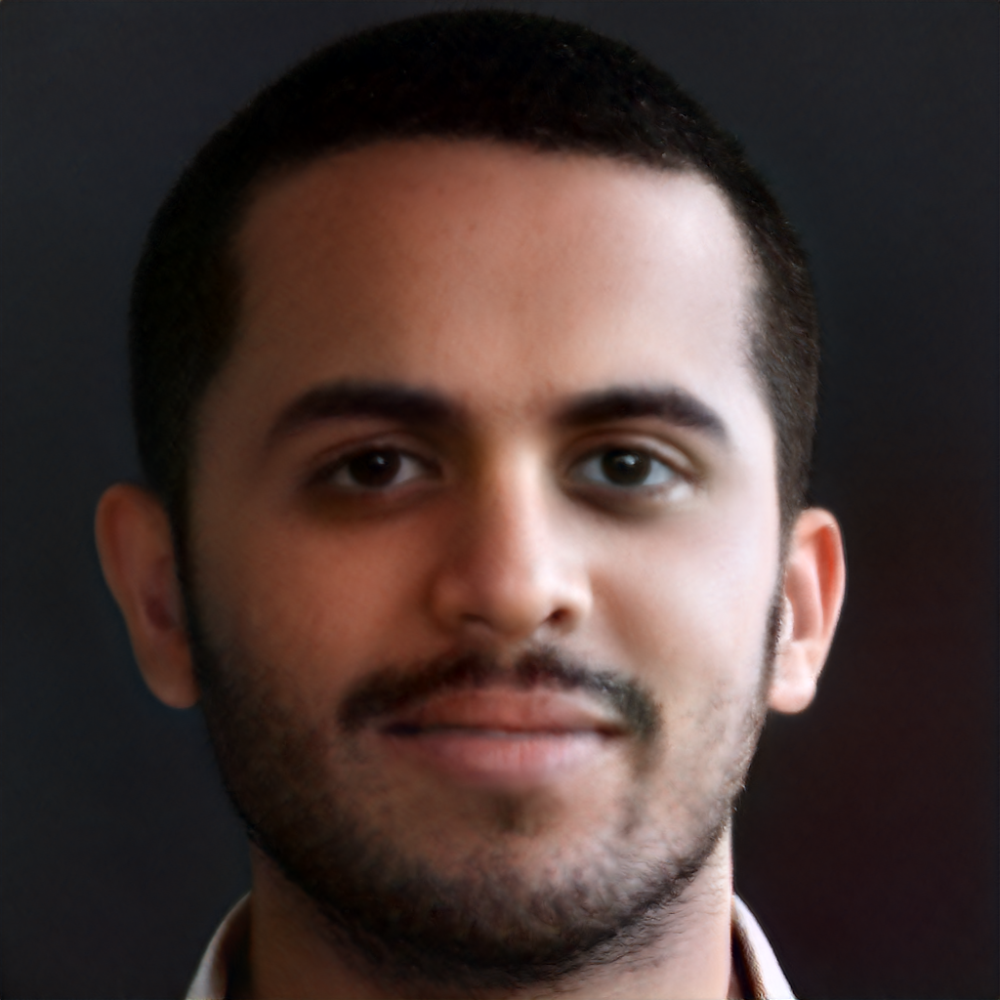

In [10]:
# Change the input image (provided in previous step) to the relevant image you want to project
! python projector.py --ckpt ckpt/stylegan2-ffhq.pt input_images/aligned/uploaded_01.png --step 500
projected_img = Image.open('projections/uploaded_01.png')
projected_img

Now we have our closest match in projected image space, depending on how closely the chosen image conforms to the content and style of photos in the Flickr Faces High Quality (FFHQ) dataset usually determines how closely we are going to be able to find a match. 

If we want to see the projection process in action, run the next cell to genereate an animation of the process.

In [11]:
# Sequence samples into video
! ffmpeg -i projection_animation/%06d.png -minrate 1024k -maxrate 1024k -c:v libx264 -pix_fmt yuv420p -strict -2 videos/projection_animation.mp4
# Delete image samples
! rm -rf projection_animation

ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lib

In [12]:
mp4 = open('videos/projection_animation.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

#Interpolation loop in *w* space

So the first thing we are going to do is something rather stupid, starting from our projected image we are then going to sample randomly directly in *w*, without trunctation. We aren't going to get good results, but it is visually instructive of the nature of the *w* space.

In [13]:
# Run script to interpolate in z space and generate individual samples
! python3 interpolation_loop_w.py --latent projections/uploaded_01.pt --truncation 1
# Sequence samples into video
! ffmpeg -i interpolation_loop_w/%06d.png -minrate 1024k -maxrate 1024k -c:v libx264 -pix_fmt yuv420p -strict -2 videos/interpolation_loop_w_no_truncation.mp4
# Delete image samples
! rm -rf interpolation_loop_w

100% 120/120 [01:12<00:00,  1.65it/s]
ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable

In [14]:
mp4 = open('videos/interpolation_loop_w_no_truncation.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

As you can see, the samples being generated are far from realsitic, quite some distance from the manifold of realistic faces. This is because we are sampling directly in *w* and large ares of the latent space of *w* don't correspond to the generation of outcomes that fit the distribution of images in the dataset. We are also not using truncation, which averages the latent vector with the mean vector as generated by the style transformer.

If we run the same code again with trunctation the results will be slightly less unusual.

In [15]:
# Run script to interpolate in z space and generate individual samples
! python3 interpolation_loop_w.py --latent projections/uploaded_01.pt --truncation 0.5
# Sequence samples into video
! ffmpeg -i interpolation_loop_w/%06d.png -minrate 1024k -maxrate 1024k -c:v libx264 -pix_fmt yuv420p -strict -2 videos/interpolation_loop_w_truncation.mp4
# Delete image samples
! rm -rf interpolation_loop_w

100% 120/120 [01:16<00:00,  1.57it/s]
ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable

In [16]:
mp4 = open('videos/interpolation_loop_w_truncation.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

The results are slightly more akin to what is found in the dataset, however they are still noticibly different from the samples we have generated in the original interpolation in *z* space (which are also generated using a trunction parameter of 0.5). This is because we are still sampling randomly in *w* space, where large areas of the space do not correspond to generation of realisitic samples.

##Understanding truncation

To better understand truncation, lets see what happens when we generate our projected image with different truncation parameters, starting from 0 on the left (which is just the mean latent vector as generated by our sample transformer) and incrementing by 0.2 until we have our original projected image on the right (truncation = 1). As you can see, by varying the truncation parameter we are varying how much the result deviates from the standard images in the dataset.

It is important to note that truncation doesn't work well for GANs trained on all datasets, especially ones that don't share any common structural similarity.

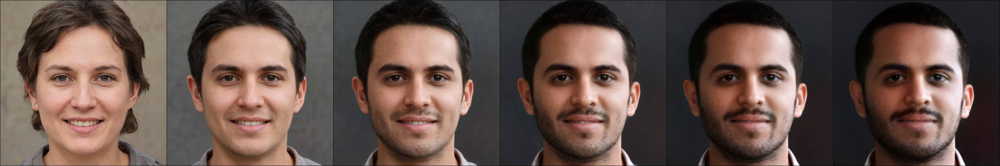

In [17]:
! python3 generate_truncation_strip.py --latent projections/uploaded_01.pt
truncation_strip = Image.open('sample/truncation_strip.png')
truncation_strip

#Interpolate between two projections

So what we are going to do next is interpolate from projected latent code to another. By default it will interpolate between your uploaded image and a projected latent code of Donald Trump, but there are also latent codes for Barack Obama, The Mona Lisa and Albert Einstein, so if you are so inclined you can switch `--latent2 projections/trump.pt` to `--latent2 projections/obama.pt`, `--latent2 projections/mona_lisa.pt` or `--latent2 projections/einstein.pt`. 

## Try with other projected latent code - against image of Einstien for example

In [18]:
# Run script to interpolate in z space and generate individual samples
! python3 interpolate_two_projections.py --latent1 projections/uploaded_01.pt --latent2 projections/trump.pt --ckpt ckpt/stylegan2-ffhq.pt
# Sequence samples into video
! ffmpeg -i interpolate_two_projections/%06d.png -minrate 1024k -maxrate 1024k -c:v libx264 -pix_fmt yuv420p -strict -2 videos/interpolate_two_projections.mp4
# Delete image samples
! rm -rf interpolate_two_projections

100% 100/100 [00:56<00:00,  1.78it/s]
ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable

In [19]:
mp4 = open('videos/interpolate_two_projections.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

And as you can see we get a very smooth video where all of the features slowly morph from one face into another.

#Style mixing between two projections

Another way of mixing two latent vectors is to perform style mixing. Here we are not changing the vectors in anyway, we are just inserting into the model at different stages, so you can start off by generating features from one vector, and then switch to the other at some layer during the generation process. Here you can see generate two strips, starting from one latent vector and switching to the other at different points in the network. You can see this is quite a different way of mixing two samples together, whereas with the interpolation, all of the features transition smoothly, with style mixing we get high level features like the head shape of one mixed with lower level features like skin tone and complexion of the other latent vector. Again the default is trump but feel free to switch these to obama, mona lisa or einstein.

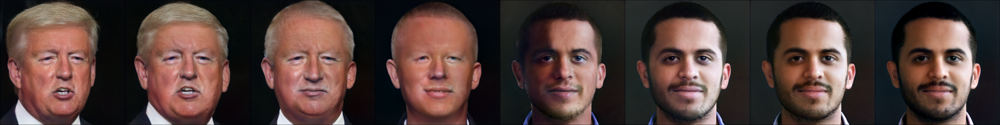

In [20]:
! python style_mix_two_projections.py --latent1 projections/uploaded_01.pt --latent2 projections/trump.pt --label example1
style_mix_strip_1 = Image.open('sample/style_mix_example1.png')
style_mix_strip_1

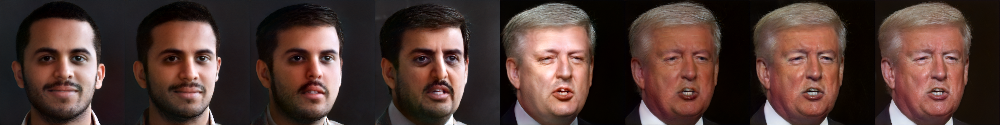

In [21]:
! python style_mix_two_projections.py --latent1 projections/trump.pt --latent2 projections/uploaded_01.pt --label example2
style_mix_strip_2 = Image.open('sample/style_mix_example2.png')
style_mix_strip_2

#Vector arithmetic on latent vectors

So one of the other interesting things you can do is vector arithmetic on latent vectors, as the process has been able to disentangle some of the linearly separate factors of variation (especially in the *w* space) it is then possible to find vectors, or directions of vectors that represent semantic properties in the image. It is then possible to do vector arithmetic on the latent vector representations, and edit semantically meaningful aspects of the image. Unfortunately we have not been able to integrate code to do this into this notebook, but here is a figure from some [a code repository](https://github.com/Puzer/stylegan-encoder) from Dimitry Nikitko to do projection and semantic image editing with the original StyleGAN, where projected codes of Donald Trump and Hilary Clinton have been combined in different ways with a vector that represents smiles, allowing smiles to be added to the image, or if the negative direction of this vector is taken and added to the latent codes it causes them to frown instead.

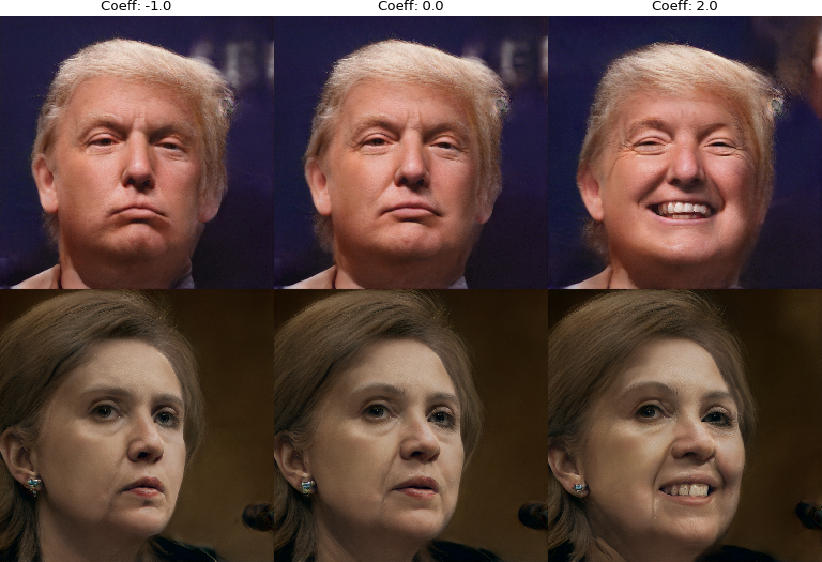

If you want to read more about what can be done with vector arithmetic in generative models you can read Tom White's 2016 paper [Sampling Generative Networks](https://arxiv.org/abs/1609.04468), or for more advanced methods that build on these principles you can refer to the [StyleGAN2 Distillation](https://arxiv.org/abs/2003.03581) paper or the [GANSpace](https://arxiv.org/abs/2004.02546) paper.

#Additional Resources

- [GAN Tutorial](https://machinelearningmastery.com/what-are-generative-adversarial-networks-gans/)

- [Ian Goodfellow's Tutorial on GAN from 2016 NIPS on YouTube](https://www.youtube.com/watch?v=HGYYEUSm-0Q)

- [Original StyleGAN paper](https://arxiv.org/abs/1812.04948), [StyleGAN2 paper](https://arxiv.org/abs/1912.04958), [StyleGAN2 official TensorFlow implementation](https://github.com/NVlabs/stylegan2).

- Sampling Generative Networks: [paper](https://arxiv.org/abs/1609.04468)

- StyleGAN2 Distillation for Feedforward image manipulation: [paper](https://arxiv.org/abs/2004.02546), [github repo](https://github.com/EvgenyKashin/stylegan2-distillation)

- GANSpace: Discovering Interpretable GAN Controls: [paper](https://arxiv.org/abs/2004.02546), [code](https://github.com/harskish/ganspace), [colab notebook](https://colab.research.google.com/github/harskish/ganspace/blob/master/notebooks/Ganspace_colab.ipynb)


- Berns and Colton. 2020. Bridging Generative Deep Learning and Computational Creativity. Proceedings of the 11th International Conference on Computational Creativity. [Paper](http://sebastianberns.com/iccc2020bridging/)

- Network Bending: Manipulating The Inner Representations of Deep Generative Models: [paper](https://arxiv.org/abs/2005.12420), [code](https://github.com/terrybroad/network-bending), [colab notebook](https://colab.research.google.com/github/dvschultz/ml-art-colabs/blob/master/Network_Bending_Static_Images.ipynb)




#Acknowledgements

Thanks to [Sebastian Berns](http://sebastianberns.com/), Queen Mary, University of London ([@sebastianberns](https://twitter.com/sebastianberns)) and [Terence Broad](https://terencebroad.com/), Goldsmiths, University of London ([@Terrybroad](https://twitter.com/Terrybroad)) for conducting this tutorial at ICCC 20 Conference.

Also thanks to the original StyleGAN & StyleGAN2 authors Tero Karras, Samuli Laine, Timo Aila, Miika Aittala, Janne Hellsten and Jaakko Lehtinen for their excellent work in advancing the state of the art of generative models.

Also thanks to Kim Seonghyeon for providing an open source [PyTorch implementation](https://github.com/rosinality/stylegan2-pytorch) used in this notebook.

Also thanks to Dmitry Nikitko for providing the [code we have used here for aligning images](https://github.com/Puzer/stylegan-encoder) before projection into StyleGAN and the figure that we have used to demonstrate the vector arithmetic.
